<a href="https://colab.research.google.com/github/hrhraj/ps3-LeRobot-/blob/main/notebooks/vineyard_SAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Segment Anything Model (SAM)

---

[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/facebookresearch/segment-anything) [![arXiv](https://img.shields.io/badge/arXiv-2304.02643-b31b1b.svg)](https://arxiv.org/abs/2304.02643)

Segment Anything Model (SAM): a new AI model from Meta AI that can "cut out" any object, in any image, with a single click. SAM is a promptable segmentation system with zero-shot generalization to unfamiliar objects and images, without the need for additional training. This notebook is an extension of the [official notebook](https://colab.research.google.com/github/facebookresearch/segment-anything/blob/main/notebooks/automatic_mask_generator_example.ipynb) prepared by Meta AI.

![segment anything model](https://media.roboflow.com/notebooks/examples/segment-anything-model-paper.png)

## Complementary Materials

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/how-to-segment-anything-with-sam.ipynb) [![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/D-D6ZmadzPE) [![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/how-to-use-segment-anything-model-sam)

We recommend that you follow along in this notebook while reading the blog post on Segment Anything Model.

![segment anything model blogpost](https://media.roboflow.com/notebooks/examples/segment-anything-model-blogpost.png)

## Pro Tip: Use GPU Acceleration

If you are running this notebook in Google Colab, navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`. This will ensure your notebook uses a GPU, which will significantly speed up model training times.

## Steps in this Tutorial

In this tutorial, we are going to cover:

- **Before you start** - Make sure you have access to the GPU
- Install Segment Anything Model (SAM)
- Download Example Data
- Load Model
- Automated Mask Generation
- Generate Segmentation with Bounding Box
- Segment Anything in Roboflow Universe Dataset

## Let's begin!

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [2]:
!nvidia-smi

Sat Apr  5 05:48:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   32C    P0             48W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [3]:
import os
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /content


## Install Segment Anything Model (SAM) and other dependencies

In [4]:
!pip install -q 'git+https://github.com/facebookresearch/segment-anything.git'

  Preparing metadata (setup.py) ... done


In [5]:
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision==0.23.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.5/151.5 kB 15.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 46.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.7/220.7 kB 23.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 116.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 765.5/765.5 kB 59.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 80.2 MB/s eta 0:00:00


### Download SAM weights

In [6]:
!mkdir -p {HOME}/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P {HOME}/weights

In [7]:
import os

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/content/weights/sam_vit_h_4b8939.pth ; exist: True


## Download Example Data

**NONE:** Let's download few example images. Feel free to use your images or videos.

In [8]:
!mkdir -p {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg -P {HOME}/data

## Load Model

In [9]:
import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

In [10]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

## Automated Mask Generation

To run automatic mask generation, provide a SAM model to the `SamAutomaticMaskGenerator` class. Set the path below to the SAM checkpoint. Running on CUDA and with the default model is recommended.

In [11]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [12]:
import os

IMAGE_NAME = "dog.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

### Generate masks with SAM

In [13]:
import cv2
import supervision as sv

image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

sam_result = mask_generator.generate(image_rgb)

### Output format

`SamAutomaticMaskGenerator` returns a `list` of masks, where each mask is a `dict` containing various information about the mask:

* `segmentation` - `[np.ndarray]` - the mask with `(W, H)` shape, and `bool` type
* `area` - `[int]` - the area of the mask in pixels
* `bbox` - `[List[int]]` - the boundary box of the mask in `xywh` format
* `predicted_iou` - `[float]` - the model's own prediction for the quality of the mask
* `point_coords` - `[List[List[float]]]` - the sampled input point that generated this mask
* `stability_score` - `[float]` - an additional measure of mask quality
* `crop_box` - `List[int]` - the crop of the image used to generate this mask in `xywh` format

In [14]:
print(sam_result[0].keys())

dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box'])


### Results visualisation with Supervision

As of version `0.5.0` Supervision has native support for SAM.

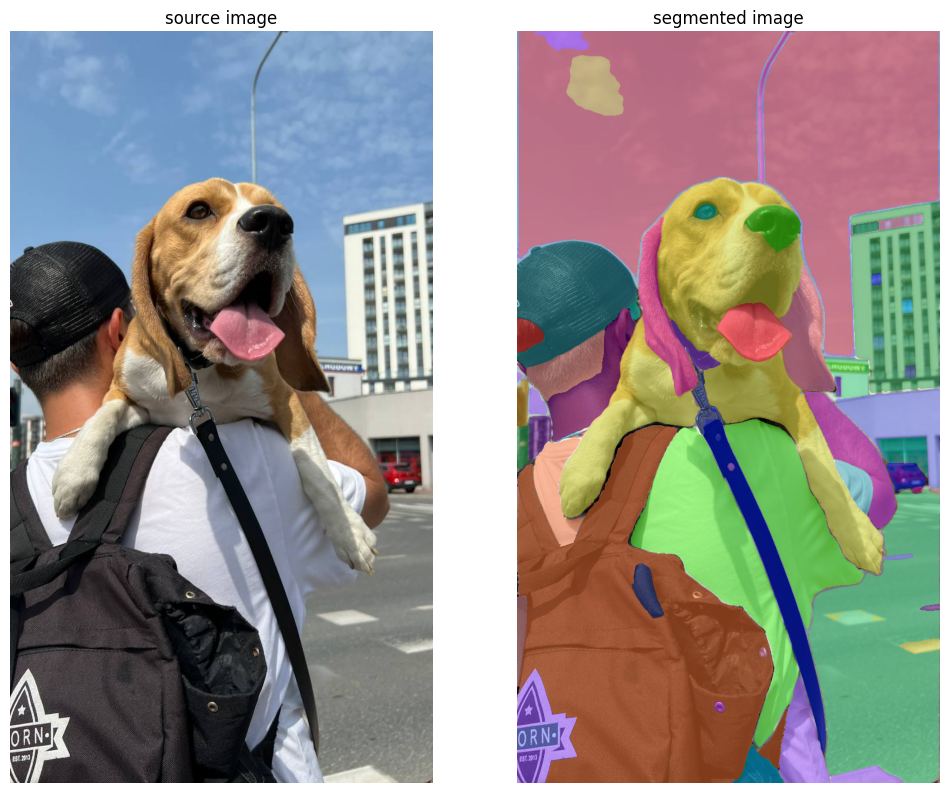

In [15]:
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections.from_sam(sam_result=sam_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

### Interaction with segmentation results

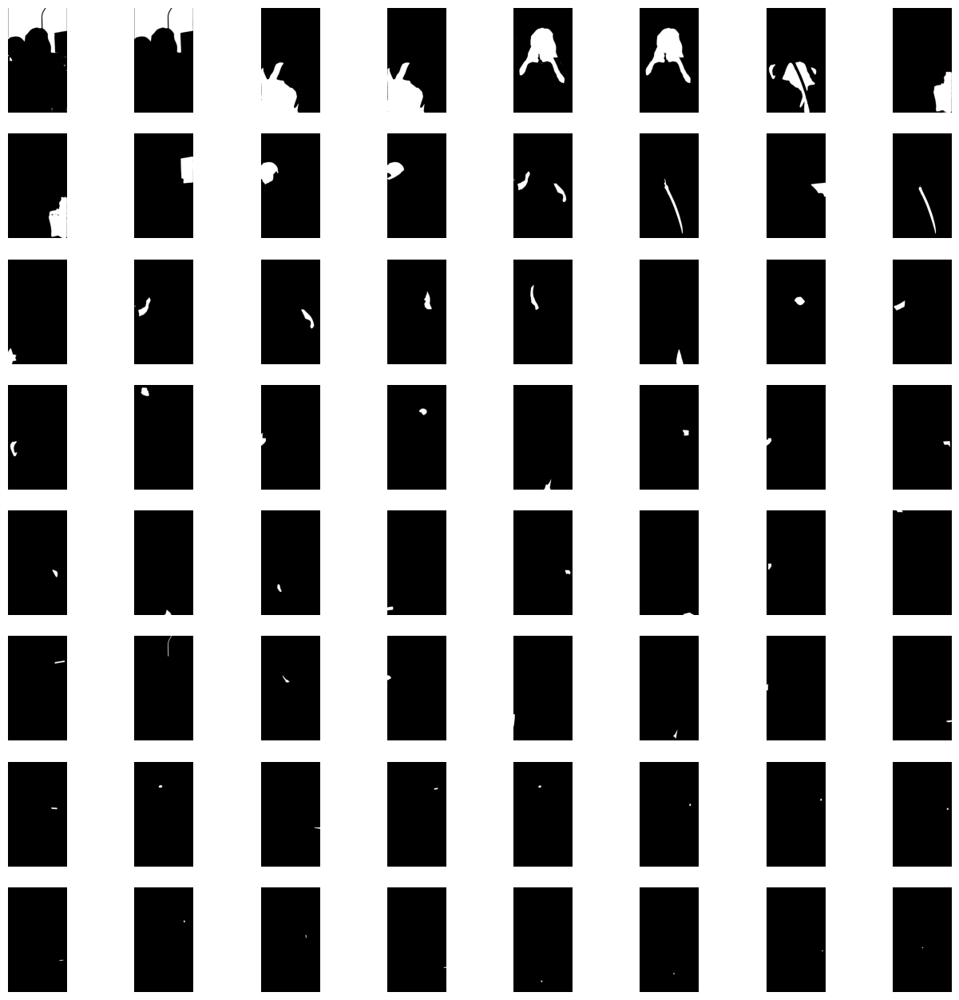

In [16]:
masks = [
    mask['segmentation']
    for mask
    in sorted(sam_result, key=lambda x: x['area'], reverse=True)
]

sv.plot_images_grid(
    images=masks,
    grid_size=(8, int(len(masks) / 8)),
    size=(16, 16)
)

## Generate Segmentation with Bounding Box

The `SamPredictor` class provides an easy interface to the model for prompting the model. It allows the user to first set an image using the `set_image` method, which calculates the necessary image embeddings. Then, prompts can be provided via the `predict` method to efficiently predict masks from those prompts. The model can take as input both point and box prompts, as well as masks from the previous iteration of prediction.

In [17]:
mask_predictor = SamPredictor(sam)

In [18]:
import os

IMAGE_NAME = "dog.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

### Draw Box



In [19]:
# helper function that loads an image before adding it to the widget

import base64

def encode_image(filepath):
    with open(filepath, 'rb') as f:
        image_bytes = f.read()
    encoded = str(base64.b64encode(image_bytes), 'utf-8')
    return "data:image/jpg;base64,"+encoded

**NOTE:** Execute cell below and use your mouse to draw bounding box on the image 👇

In [20]:
IS_COLAB = True

if IS_COLAB:
    from google.colab import output
    output.enable_custom_widget_manager()

from jupyter_bbox_widget import BBoxWidget

widget = BBoxWidget()
widget.image = encode_image(IMAGE_PATH)
widget

BBoxWidget(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#b…

In [21]:
widget.bboxes

[]

### Generate masks with SAM

**NOTE:** `SamPredictor.predict` method takes `np.ndarray` `box` argument in `[x_min, y_min, x_max, y_max]` format. Let's reorganise your data first

In [22]:
import numpy as np

# default_box is going to be used if you will not draw any box on image above
default_box = {'x': 68, 'y': 247, 'width': 555, 'height': 678, 'label': ''}

box = widget.bboxes[0] if widget.bboxes else default_box
box = np.array([
    box['x'],
    box['y'],
    box['x'] + box['width'],
    box['y'] + box['height']
])

In [23]:
import cv2
import numpy as np
import supervision as sv

image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

mask_predictor.set_image(image_rgb)

masks, scores, logits = mask_predictor.predict(
    box=box,
    multimask_output=True
)

### Results visualisation with Supervision

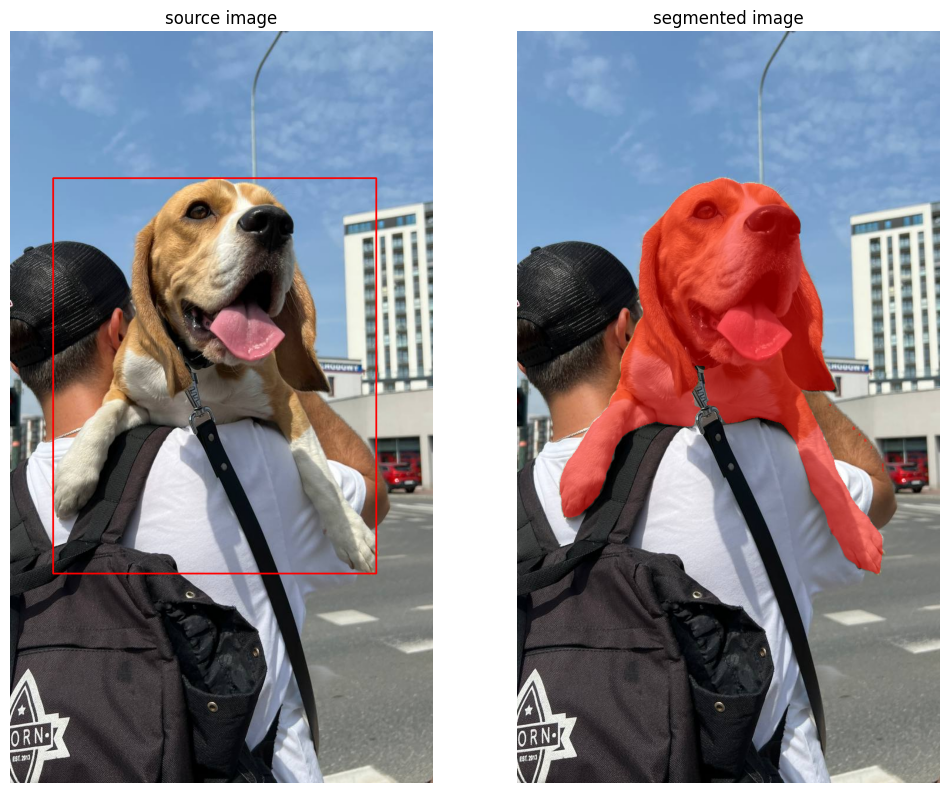

In [24]:
box_annotator = sv.BoxAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=masks),
    mask=masks
)
detections = detections[detections.area == np.max(detections.area)]

source_image = box_annotator.annotate(scene=image_bgr.copy(), detections=detections)
segmented_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[source_image, segmented_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

### Interaction with segmentation results

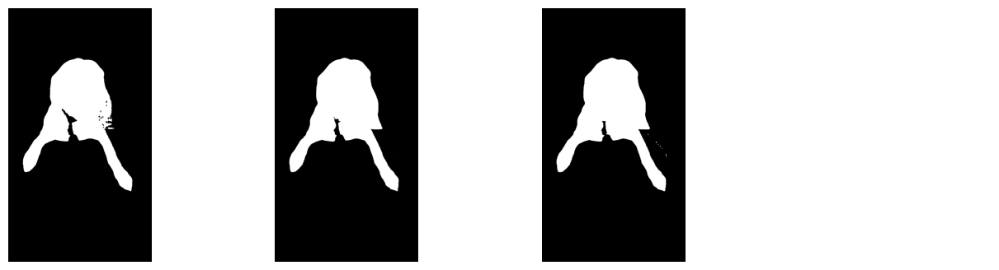

In [25]:
import supervision as v

sv.plot_images_grid(
    images=masks,
    grid_size=(1, 4),
    size=(16, 4)
)

## Segment Anything in Roboflow Universe Dataset

### Utils Supporting Dataset Processing

A couple of helper functions that, unfortunately, we have to write ourselves to facilitate the processing of COCO annotations.

In [26]:
import numpy as np
from dataclasses import dataclass
from typing import List, Tuple, Union, Optional
from dataclasses_json import dataclass_json
from supervision import Detections


@dataclass_json
@dataclass
class COCOCategory:
    id: int
    name: str
    supercategory: str


@dataclass_json
@dataclass
class COCOImage:
    id: int
    width: int
    height: int
    file_name: str
    license: int
    date_captured: str
    coco_url: Optional[str] = None
    flickr_url: Optional[str] = None


@dataclass_json
@dataclass
class COCOAnnotation:
    id: int
    image_id: int
    category_id: int
    segmentation: List[List[float]]
    area: float
    bbox: Tuple[float, float, float, float]
    iscrowd: int


@dataclass_json
@dataclass
class COCOLicense:
    id: int
    name: str
    url: str


@dataclass_json
@dataclass
class COCOJson:
    images: List[COCOImage]
    annotations: List[COCOAnnotation]
    categories: List[COCOCategory]
    licenses: List[COCOLicense]


def load_coco_json(json_file: str) -> COCOJson:
    import json

    with open(json_file, "r") as f:
        json_data = json.load(f)

    return COCOJson.from_dict(json_data)


class COCOJsonUtility:
    @staticmethod
    def get_annotations_by_image_id(coco_data: COCOJson, image_id: int) -> List[COCOAnnotation]:
        return [annotation for annotation in coco_data.annotations if annotation.image_id == image_id]

    @staticmethod
    def get_annotations_by_image_path(coco_data: COCOJson, image_path: str) -> Optional[List[COCOAnnotation]]:
        image = COCOJsonUtility.get_image_by_path(coco_data, image_path)
        if image:
            return COCOJsonUtility.get_annotations_by_image_id(coco_data, image.id)
        else:
            return None

    @staticmethod
    def get_image_by_path(coco_data: COCOJson, image_path: str) -> Optional[COCOImage]:
        for image in coco_data.images:
            if image.file_name == image_path:
                return image
        return None

    @staticmethod
    def annotations2detections(annotations: List[COCOAnnotation]) -> Detections:
        class_id, xyxy = [], []

        for annotation in annotations:
            x_min, y_min, width, height = annotation.bbox
            class_id.append(annotation.category_id)
            xyxy.append([
                x_min,
                y_min,
                x_min + width,
                y_min + height
            ])

        return Detections(
            xyxy=np.array(xyxy, dtype=int),
            class_id=np.array(class_id, dtype=int)
        )

### Download Dataset from Roboflow

In [27]:
%cd {HOME}

import roboflow
from roboflow import Roboflow

roboflow.login()

rf = Roboflow()

project = rf.workspace("hashira-fhxpj").project("mri-brain-tumor")
dataset = project.version(1).download("coco")

/content
visit https://app.roboflow.com/auth-cli to get your authentication token.
Paste the authentication token here: ··········
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to MRI-BRAIN-TUMOR-1 in coco:: 100%|██████████| 85/85 [00:00<00:00, 8215.03it/s]


In [28]:
import os

DATA_SET_SUBDIRECTORY = "test"
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"
IMAGES_DIRECTORY_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY)
ANNOTATIONS_FILE_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY, ANNOTATIONS_FILE_NAME)

In [29]:
coco_data = load_coco_json(json_file=ANNOTATIONS_FILE_PATH)

CLASSES = [
    category.name
    for category
    in coco_data.categories
    if category.supercategory != 'none'
]

IMAGES = [
    image.file_name
    for image
    in coco_data.images
]

In [30]:
CLASSES

['YES-TUMOR']

### Single Image Bounding Box to Mask

In [31]:
# set random seed to allow easy reproduction of the experiment

import random
random.seed(10)

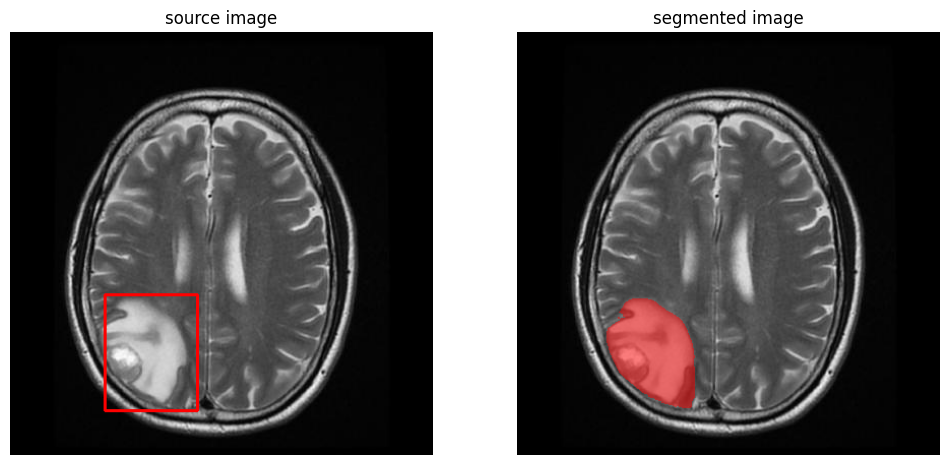

In [32]:
EXAMPLE_IMAGE_NAME = random.choice(IMAGES)
EXAMPLE_IMAGE_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY, EXAMPLE_IMAGE_NAME)

# load dataset annotations
annotations = COCOJsonUtility.get_annotations_by_image_path(coco_data=coco_data, image_path=EXAMPLE_IMAGE_NAME)
ground_truth = COCOJsonUtility.annotations2detections(annotations=annotations)

# small hack - coco numerate classes from 1, model from 0 + we drop first redundant class from coco json
ground_truth.class_id = ground_truth.class_id - 1

# load image
image_bgr = cv2.imread(EXAMPLE_IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

# initiate annotator
box_annotator = sv.BoxAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)

# annotate ground truth
annotated_frame_ground_truth = box_annotator.annotate(scene=image_bgr.copy(), detections=ground_truth)

# run SAM inference
mask_predictor.set_image(image_rgb)

masks, scores, logits = mask_predictor.predict(
    box=ground_truth.xyxy[0],
    multimask_output=True
)

detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=masks),
    mask=masks
)
detections = detections[detections.area == np.max(detections.area)]

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[annotated_frame_ground_truth, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.

Found these images:
 - /content/IMG_1884.JPG

Using image: /content/IMG_1884.JPG


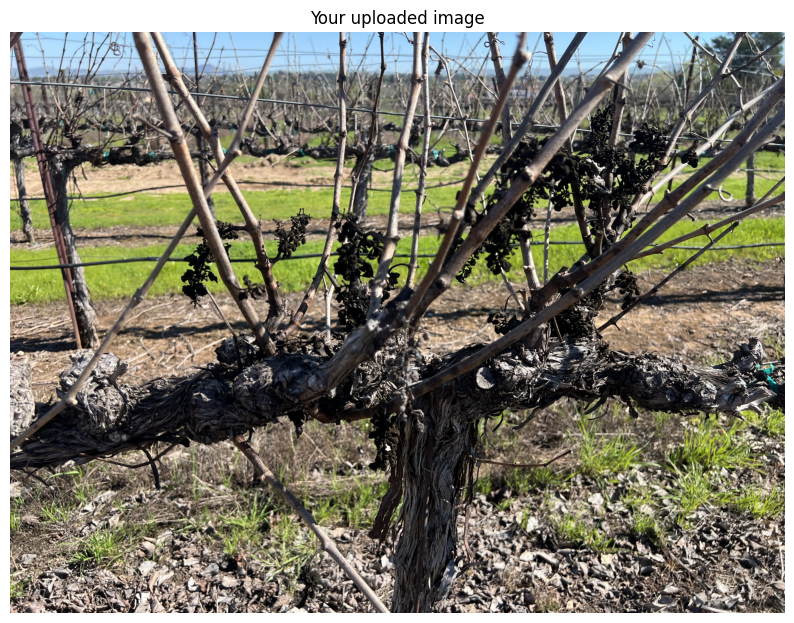

In [33]:
# Find your uploaded image
import os
from glob import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

# List all image files in the Colab environment
image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']
all_images = []
for ext in image_extensions:
    all_images.extend(glob(f'/content/{ext}'))

print("Found these images:")
for img_path in all_images:
    print(f" - {img_path}")

# If no images found in /content, look in subdirectories
if not all_images:
    for ext in image_extensions:
        all_images.extend(glob(f'/content/**/{ext}', recursive=True))
    print("\nFound these images in subdirectories:")
    for img_path in all_images:
        print(f" - {img_path}")

# Let's use the first image found (or you can change the index if multiple images)
if all_images:
    image_path = all_images[0]  # Use the first image found
    print(f"\nUsing image: {image_path}")

    # Display the image
    img = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(np.array(img))
    plt.axis('off')
    plt.title("Your uploaded image")
    plt.show()
else:
    print("No images found. Please upload an image.")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 119.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 87.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 95.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjit

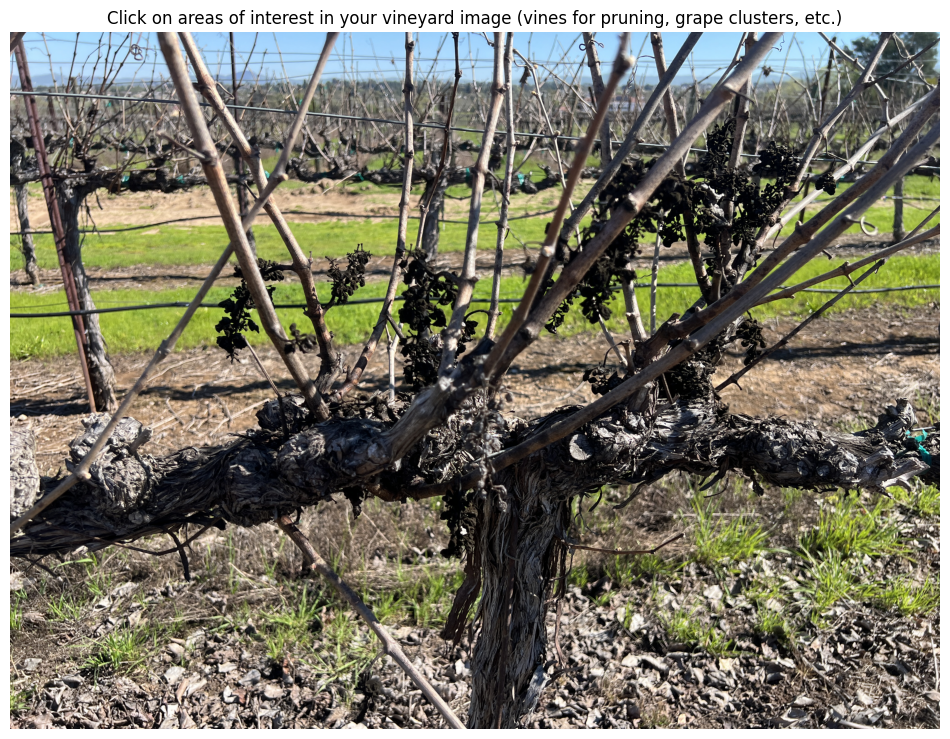

In [34]:
# Install necessary packages if you haven't already
!pip install opencv-python matplotlib segment-anything torch

# Download SAM model weights if not already downloaded
!mkdir -p sam_weights
!wget -nc https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P sam_weights

# Import SAM
from segment_anything import sam_model_registry, SamPredictor

# Load the SAM model
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
sam = sam_model_registry["vit_h"](checkpoint="/content/sam_weights/sam_vit_h_4b8939.pth")
sam.to(device=device)
predictor = SamPredictor(sam)

# Load your image (using the image_path found in the previous code block)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
predictor.set_image(image)

# Create an interactive segmentation function
def segment_on_click(event):
    if event.button == 1:  # Left mouse button
        # Get x, y coordinates of click
        x, y = int(event.xdata), int(event.ydata)
        print(f"Clicked at position: ({x}, {y})")

        # Generate mask for the clicked point
        input_point = np.array([[x, y]])
        input_label = np.array([1])  # 1 indicates foreground point

        # Predict the mask
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True
        )

        # Get the best mask (highest score)
        best_mask_idx = np.argmax(scores)
        mask = masks[best_mask_idx]

        # Display the result
        plt.figure(figsize=(15, 10))

        # Show original image
        plt.subplot(1, 2, 1)
        plt.imshow(image)
        plt.scatter(x, y, color='red', s=40)
        plt.title("Input Point")
        plt.axis('off')

        # Show image with mask overlay
        plt.subplot(1, 2, 2)
        plt.imshow(image)
        colored_mask = np.zeros_like(image)
        colored_mask[mask] = [0, 255, 0]  # Green overlay for segmented area
        plt.imshow(colored_mask, alpha=0.5)  # Overlay with transparency
        plt.title(f"Segmentation (Score: {scores[best_mask_idx]:.3f})")
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        # Additional vineyard analysis
        segmented_pixels = np.sum(mask)
        total_pixels = mask.shape[0] * mask.shape[1]
        coverage_percent = (segmented_pixels / total_pixels) * 100

        print(f"Analysis of segmented region:")
        print(f"- Area: {segmented_pixels} pixels")
        print(f"- Coverage: {coverage_percent:.2f}% of image")

        # For vineyard specific guidance
        if coverage_percent < 5:
            print("This appears to be a small feature (possibly individual vine or small grape cluster)")
        elif coverage_percent < 15:
            print("This appears to be a medium-sized feature (possibly a vine branch or grape bunch)")
        else:
            print("This appears to be a large feature (possibly multiple vines or a section needing pruning)")

# Create interactive figure
plt.figure(figsize=(12, 12))
plt.imshow(image)
plt.title("Click on areas of interest in your vineyard image (vines for pruning, grape clusters, etc.)")
plt.axis('off')

# Connect the click event to our function
fig = plt.gcf()
fig.canvas.mpl_connect('button_press_event', segment_on_click)
plt.show()

File ‘sam_weights/sam_vit_h_4b8939.pth’ already there; not retrieving.

Using image: /content/IMG_1884.JPG


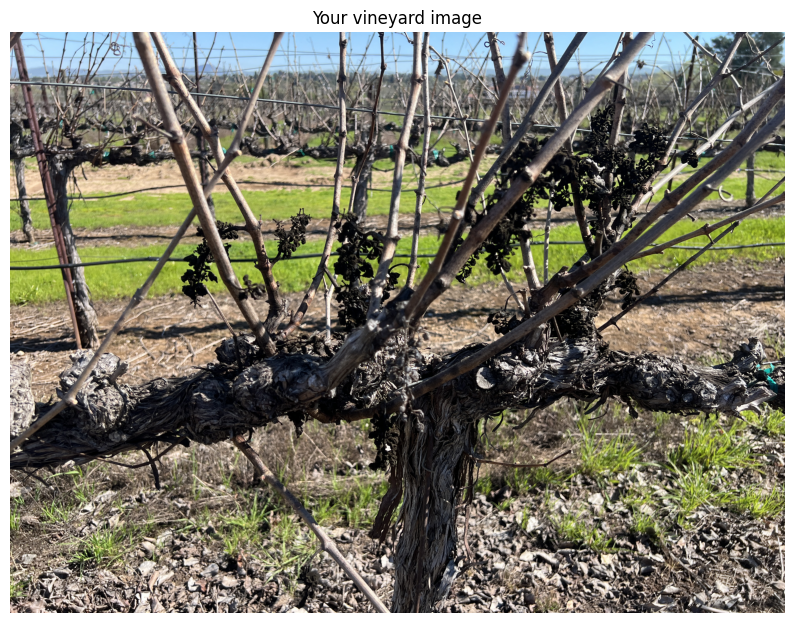

Loading SAM model...
Image dimensions: 4032x3024
Analyzing image with 5x5 grid...
Processed 5/25 points
Processed 10/25 points
Processed 15/25 points
Processed 20/25 points
Processed 25/25 points


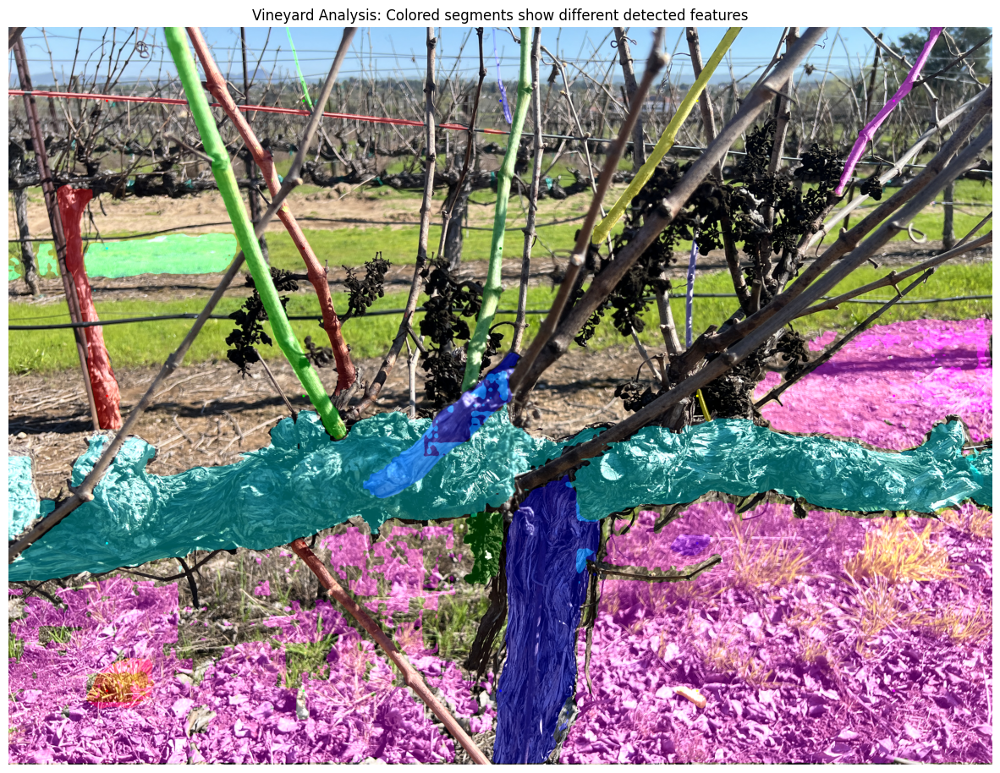

Result saved to: /content/vineyard_analysis_result.jpg

Vineyard Analysis Results:
- Total vineyard features detected: 5524306 pixels
- Coverage: 45.31% of image


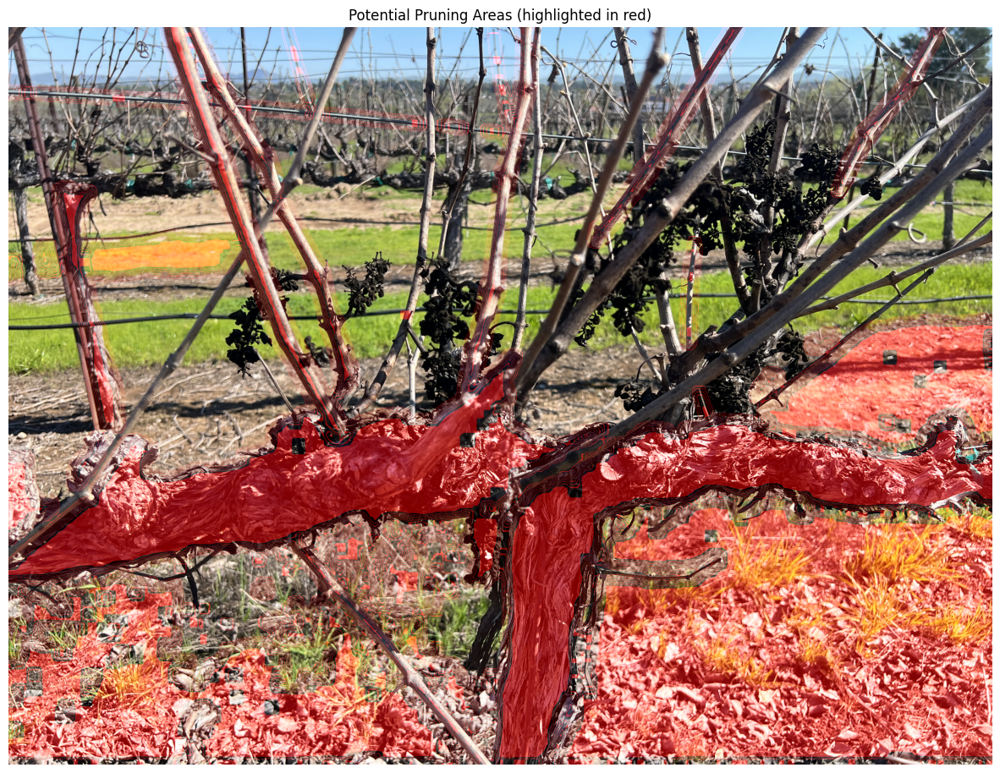

Pruning analysis saved to: /content/vineyard_pruning_analysis.jpg


In [35]:
# Install required packages
!pip install opencv-python matplotlib segment-anything torch

# Download SAM model weights
!mkdir -p sam_weights
!wget -nc https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P sam_weights

# Import necessary libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import torch
from PIL import Image, ImageDraw
import time

# Find your image
import os
from glob import glob

# List all image files in the Colab environment
image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']
all_images = []
for ext in image_extensions:
    all_images.extend(glob(f'/content/{ext}'))

# If no images found in /content, look in subdirectories
if not all_images:
    for ext in image_extensions:
        all_images.extend(glob(f'/content/**/{ext}', recursive=True))

if all_images:
    image_path = all_images[0]  # Use the first image found
    print(f"Using image: {image_path}")

    # Display the image
    img = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(np.array(img))
    plt.axis('off')
    plt.title("Your vineyard image")
    plt.show()
else:
    print("No images found. Please upload an image.")
    # Exit if no images found
    raise Exception("Please upload an image before running this code")

# Load the SAM model
print("Loading SAM model...")
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
sam = sam_model_registry["vit_h"](checkpoint="/content/sam_weights/sam_vit_h_4b8939.pth")
sam.to(device=device)
predictor = SamPredictor(sam)

# Load your image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
height, width = image.shape[:2]
print(f"Image dimensions: {width}x{height}")

# Set image in predictor
predictor.set_image(image)

# Create a grid of points to analyze the entire image
def analyze_image_with_grid(grid_size=5):
    print(f"Analyzing image with {grid_size}x{grid_size} grid...")

    # Create grid of points
    x_points = np.linspace(width * 0.1, width * 0.9, grid_size)
    y_points = np.linspace(height * 0.1, height * 0.9, grid_size)

    grid_points = []
    for y in y_points:
        for x in x_points:
            grid_points.append([int(x), int(y)])

    # Create a composite mask to show all segmentations
    composite_mask = np.zeros((height, width), dtype=bool)

    # Create a color image for visualization
    result_image = image.copy()

    # Colors for different segments
    colors = [
        [255, 0, 0],    # Red
        [0, 255, 0],    # Green
        [0, 0, 255],    # Blue
        [255, 255, 0],  # Yellow
        [255, 0, 255],  # Magenta
        [0, 255, 255],  # Cyan
        [128, 0, 0],    # Maroon
        [0, 128, 0],    # Dark Green
        [0, 0, 128],    # Navy
        [128, 128, 0],  # Olive
    ]

    # Process each point
    for i, point in enumerate(grid_points):
        # Get coordinates
        x, y = point

        # Skip if too close to an already segmented area
        if composite_mask[y, x]:
            continue

        # Create input for SAM
        input_point = np.array([[x, y]])
        input_label = np.array([1])

        # Generate mask
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True
        )

        # Get best mask
        best_mask_idx = np.argmax(scores)
        mask = masks[best_mask_idx]
        score = scores[best_mask_idx]

        # Only keep significant masks
        if np.sum(mask) > 100 and score > 0.7:
            # Add to composite mask
            composite_mask = composite_mask | mask

            # Add colored overlay to result image
            color = colors[i % len(colors)]
            color_mask = np.zeros_like(result_image)
            color_mask[mask] = color
            result_image = cv2.addWeighted(result_image, 1, color_mask, 0.35, 0)

            # Draw the point
            cv2.circle(result_image, (x, y), 5, color, -1)

        # Show progress every few points
        if (i+1) % 5 == 0 or i == len(grid_points)-1:
            print(f"Processed {i+1}/{len(grid_points)} points")

    return result_image, composite_mask

# Run the analysis with a 5x5 grid (25 points across the image)
result_image, mask = analyze_image_with_grid(grid_size=5)

# Display the result
plt.figure(figsize=(15, 15))
plt.imshow(result_image)
plt.title("Vineyard Analysis: Colored segments show different detected features")
plt.axis('off')
plt.show()

# Save the result
output_path = "/content/vineyard_analysis_result.jpg"
plt.imsave(output_path, result_image)
print(f"Result saved to: {output_path}")

# Additional vineyard-specific analysis
# Calculate total segmented area
segmented_pixels = np.sum(mask)
total_pixels = mask.shape[0] * mask.shape[1]
coverage_percent = (segmented_pixels / total_pixels) * 100

print("\nVineyard Analysis Results:")
print(f"- Total vineyard features detected: {segmented_pixels} pixels")
print(f"- Coverage: {coverage_percent:.2f}% of image")

# Create a visualization showing areas that might need pruning (complex areas with many segments)
# This uses a kernel to find areas where many segments meet or overlap
from scipy import ndimage

# Create heat map of segment density
kernel = np.ones((50, 50), np.uint8)  # Adjust size based on image resolution
density = ndimage.convolve(mask.astype(np.uint8), kernel)
normalized_density = density / np.max(density)

# Areas with high density might need pruning
pruning_mask = normalized_density > 0.7

# Create pruning visualization
pruning_overlay = np.zeros_like(image)
pruning_overlay[pruning_mask] = [255, 0, 0]  # Red for areas that might need pruning

pruning_result = cv2.addWeighted(image, 1, pruning_overlay, 0.5, 0)

plt.figure(figsize=(15, 15))
plt.imshow(pruning_result)
plt.title("Potential Pruning Areas (highlighted in red)")
plt.axis('off')
plt.show()

# Save pruning analysis
pruning_path = "/content/vineyard_pruning_analysis.jpg"
plt.imsave(pruning_path, pruning_result)
print(f"Pruning analysis saved to: {pruning_path}")

File ‘sam_weights/sam_vit_h_4b8939.pth’ already there; not retrieving.

Using image: /content/vineyard_pruning_analysis.jpg


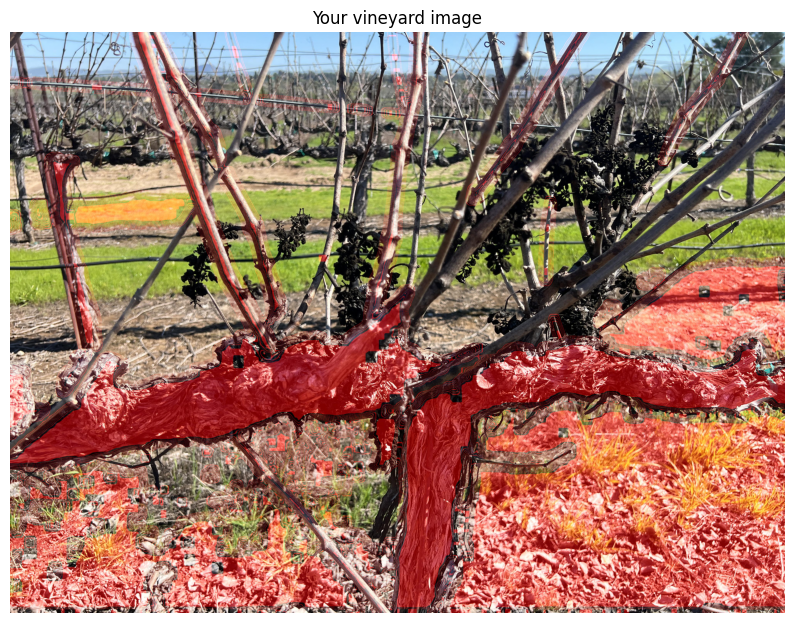

Loading SAM model...
Image dimensions: 4032x3024
Analyzing image with 8x8 grid...
Processed 10/84 points
Processed 20/84 points
Processed 30/84 points
Processed 50/84 points
Processed 60/84 points
Finding pruning points and marking with red X's...
Marked 20 potential pruning points with red X's


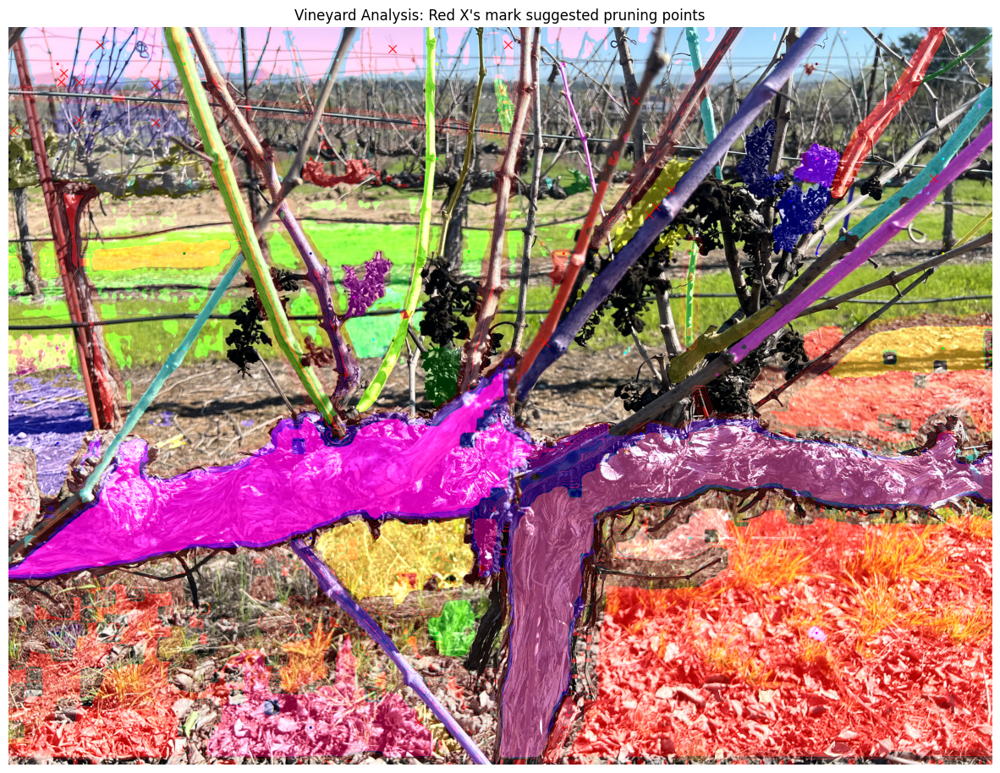

Result with pruning points saved to: /content/vineyard_pruning_marked.jpg


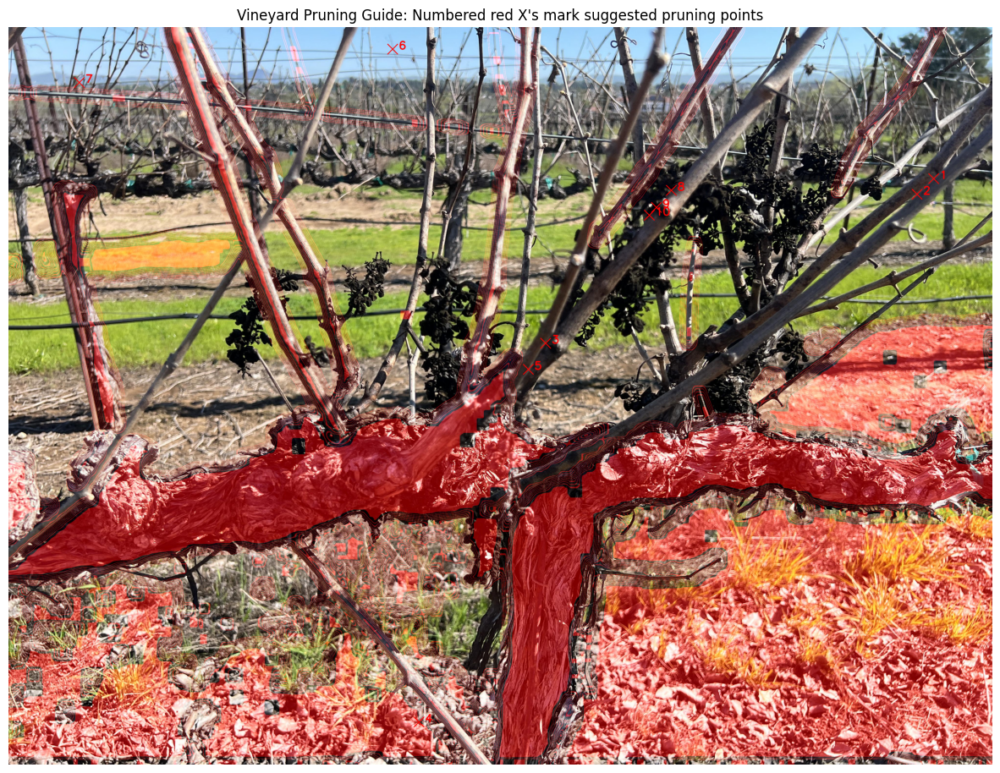

Pruning guide saved to: /content/vineyard_pruning_guide.jpg

Vineyard Pruning Analysis Summary:
- Total potential pruning points identified: 20
- Red X's mark recommended cutting locations
- Two result images saved:
  1. /content/vineyard_pruning_marked.jpg - Full analysis with all detected features
  2. /content/vineyard_pruning_guide.jpg - Pruning guide with numbered pruning points


In [36]:
# Install required packages
!pip install opencv-python matplotlib segment-anything torch scipy scikit-image

# Download SAM model weights (if not already downloaded)
!mkdir -p sam_weights
!wget -nc https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P sam_weights

# Import necessary libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamPredictor
import torch
from PIL import Image, ImageDraw
from scipy import ndimage
from skimage.morphology import skeletonize, thin
from skimage.feature import peak_local_max
import os
from glob import glob

# Find your image
image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']
all_images = []
for ext in image_extensions:
    all_images.extend(glob(f'/content/{ext}'))

# If no images found in /content, look in subdirectories
if not all_images:
    for ext in image_extensions:
        all_images.extend(glob(f'/content/**/{ext}', recursive=True))

if all_images:
    image_path = all_images[0]  # Use the first image found
    print(f"Using image: {image_path}")

    # Display the image
    img = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(np.array(img))
    plt.axis('off')
    plt.title("Your vineyard image")
    plt.show()
else:
    print("No images found. Please upload an image.")
    raise Exception("Please upload an image before running this code")

# Load the SAM model
print("Loading SAM model...")
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
sam = sam_model_registry["vit_h"](checkpoint="/content/sam_weights/sam_vit_h_4b8939.pth")
sam.to(device=device)
predictor = SamPredictor(sam)

# Load your image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
height, width = image.shape[:2]
print(f"Image dimensions: {width}x{height}")

# Set image in predictor
predictor.set_image(image)

# Create a grid of points to analyze the entire image - INCREASED DENSITY for better stem detection
def analyze_image_with_grid(grid_size=8):  # Increased from 5x5 to 8x8 for better coverage
    print(f"Analyzing image with {grid_size}x{grid_size} grid...")

    # Create a more comprehensive grid of points
    x_points = np.linspace(width * 0.05, width * 0.95, grid_size)  # Expanded coverage area
    y_points = np.linspace(height * 0.05, height * 0.95, grid_size)

    grid_points = []
    for y in y_points:
        for x in x_points:
            grid_points.append([int(x), int(y)])

    # Add extra points in a random pattern to catch stems in different orientations
    np.random.seed(42)  # For reproducibility
    extra_points = 20  # Add extra random points to catch more stems
    for _ in range(extra_points):
        x = np.random.randint(int(width * 0.05), int(width * 0.95))
        y = np.random.randint(int(height * 0.05), int(height * 0.95))
        grid_points.append([x, y])

    # Create a composite mask to show all segmentations
    composite_mask = np.zeros((height, width), dtype=bool)

    # Create a color image for visualization
    result_image = image.copy()

    # Colors for different segments
    colors = [
        [255, 0, 0],    # Red
        [0, 255, 0],    # Green
        [0, 0, 255],    # Blue
        [255, 255, 0],  # Yellow
        [255, 0, 255],  # Magenta
        [0, 255, 255],  # Cyan
        [128, 0, 0],    # Maroon
        [0, 128, 0],    # Dark Green
        [0, 0, 128],    # Navy
        [128, 128, 0],  # Olive
    ]

    # Store all masks for later analysis
    all_masks = []

    # Process each point
    for i, point in enumerate(grid_points):
        # Get coordinates
        x, y = point

        # Skip if too close to an already segmented area (but with smaller threshold to catch stems)
        if composite_mask[y, x]:
            continue

        # Create input for SAM
        input_point = np.array([[x, y]])
        input_label = np.array([1])

        # Generate mask - get multiple masks for better stem detection
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True
        )

        # IMPROVED: Check all masks, not just the best one, to catch more stems
        for mask_idx, (mask, score) in enumerate(zip(masks, scores)):
            # Lower threshold for stem detection
            if np.sum(mask) > 50 and score > 0.5:  # More lenient thresholds
                # Add to composite mask
                composite_mask = composite_mask | mask
                all_masks.append(mask)

                # Add colored overlay to result image
                color = colors[i % len(colors)]
                color_mask = np.zeros_like(result_image)
                color_mask[mask] = color
                result_image = cv2.addWeighted(result_image, 1, color_mask, 0.35, 0)

                # Draw the point
                cv2.circle(result_image, (x, y), 5, color, -1)
                break  # We only need one good mask per point

        # Show progress
        if (i+1) % 10 == 0 or i == len(grid_points)-1:
            print(f"Processed {i+1}/{len(grid_points)} points")

    return result_image, composite_mask, all_masks

# Run the analysis with improved grid
result_image, mask, all_masks = analyze_image_with_grid(grid_size=8)  # Increased density

# Find pruning points and mark with red X's
def mark_pruning_points(image, masks, composite_mask):
    print("Finding pruning points and marking with red X's...")
    result = image.copy()

    # Create a skeletonized version of the mask to find branch structures
    skeleton = skeletonize(composite_mask)

    # Find branch junctions using a convolution approach
    kernel = np.ones((5, 5), np.uint8)
    branch_density = ndimage.convolve(skeleton.astype(np.uint8), kernel)

    # Points with high values are likely junctions
    junction_threshold = 3  # Adjust based on your images
    junction_candidates = branch_density > junction_threshold

    # Find local maxima as pruning points
    pruning_points = peak_local_max(
        branch_density,
        min_distance=30,  # Minimum distance between pruning points
        threshold_abs=junction_threshold,
        exclude_border=10,
        num_peaks=20  # Limit number of pruning points to avoid too many markers
    )

    # Draw red X at each pruning point
    for point in pruning_points:
        y, x = point
        # Only mark if it's on an actual vine (avoid marking background)
        if composite_mask[y, x]:
            # Draw a red X (two crossed lines)
            size = 15  # Size of the X
            thickness = 3  # Thickness of the lines
            cv2.line(result, (x-size, y-size), (x+size, y+size), (255, 0, 0), thickness)
            cv2.line(result, (x+size, y-size), (x-size, y+size), (255, 0, 0), thickness)

    print(f"Marked {len(pruning_points)} potential pruning points with red X's")
    return result, pruning_points

# Mark pruning points with red X's
pruning_result, pruning_points = mark_pruning_points(result_image, all_masks, mask)

# Display the result with pruning points marked
plt.figure(figsize=(15, 15))
plt.imshow(pruning_result)
plt.title("Vineyard Analysis: Red X's mark suggested pruning points")
plt.axis('off')
plt.show()

# Save the result
output_path = "/content/vineyard_pruning_marked.jpg"
plt.imsave(output_path, pruning_result)
print(f"Result with pruning points saved to: {output_path}")

# Create a zoomed version focusing just on pruning points
def create_pruning_guide(image, pruning_points):
    result = image.copy()

    # For each pruning point, create a zoomed inset
    for i, (y, x) in enumerate(pruning_points[:10]):  # Limit to first 10 points
        # Draw a larger, more visible X
        size = 20
        thickness = 4
        cv2.line(result, (x-size, y-size), (x+size, y+size), (255, 0, 0), thickness)
        cv2.line(result, (x+size, y-size), (x-size, y+size), (255, 0, 0), thickness)

        # Add a number label
        cv2.putText(result, str(i+1), (x+size+5, y), cv2.FONT_HERSHEY_SIMPLEX,
                    1.5, (255, 0, 0), 3, cv2.LINE_AA)

    return result

# Create a pruning guide with numbered points
pruning_guide = create_pruning_guide(image, pruning_points)

plt.figure(figsize=(15, 15))
plt.imshow(pruning_guide)
plt.title("Vineyard Pruning Guide: Numbered red X's mark suggested pruning points")
plt.axis('off')
plt.show()

# Save the pruning guide
guide_path = "/content/vineyard_pruning_guide.jpg"
plt.imsave(guide_path, pruning_guide)
print(f"Pruning guide saved to: {guide_path}")

print("\nVineyard Pruning Analysis Summary:")
print(f"- Total potential pruning points identified: {len(pruning_points)}")
print(f"- Red X's mark recommended cutting locations")
print(f"- Two result images saved:")
print(f"  1. {output_path} - Full analysis with all detected features")
print(f"  2. {guide_path} - Pruning guide with numbered pruning points")